In [1]:
from utils import read_data, simple_predictors, evaluation, rollingCV, viz, knn, random_forest, predictions
import pandas as pd
import numpy as np
from IPython.display import display

In [2]:
RD = read_data.ReadData()
viz = viz.Viz()
Eval = evaluation.Evaluation()
hd = RD.read_Hd()
K = 8
RCV = rollingCV.RollingCV(hd[::-1], K, 30, 14, 30)
SimplePredictors = simple_predictors.SimplePredictors(hd)
KNN = knn.KNN(Eval, 60)
RandomForest = random_forest.RandomForest(Eval)

In [3]:
predictions = predictions.Predictions()
test_sets =  RCV.getTestSets()
test_sets_ML = RCV.getTestSets(isML=True)
points_of_sales = sorted(hd.id.unique())

In [4]:
MAEs = []
RSMEs = []
MAPEs = []
CUSTOMs = []

In [5]:
show_product = 'product1'
# show_product = 'product2'

### Mean sale value from last N sale days

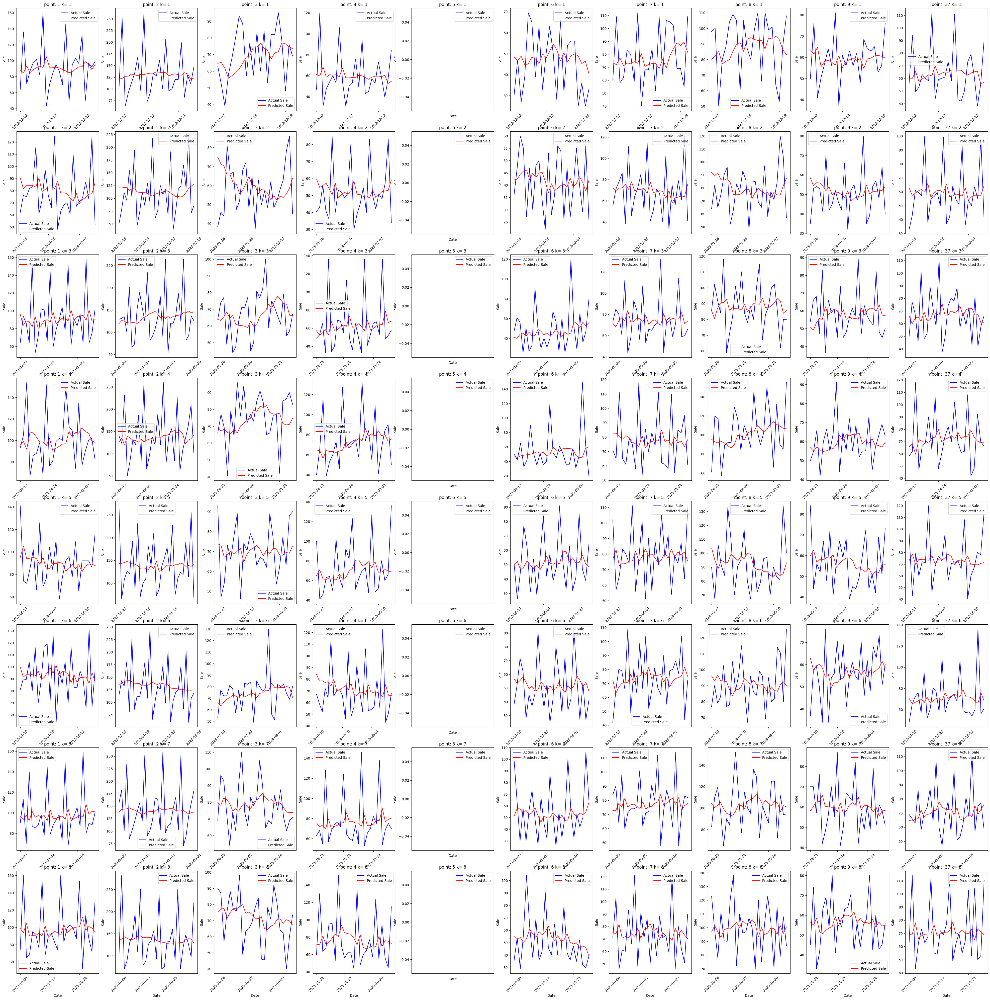

In [6]:
mean_predictions = []
for k in range(1, K+1):
    pred = predictions.getPredictions("mean_predictions", k)
    mean_predictions.append(pred)
viz.show_sales(mean_predictions, test_sets, points_of_sales, show_product)

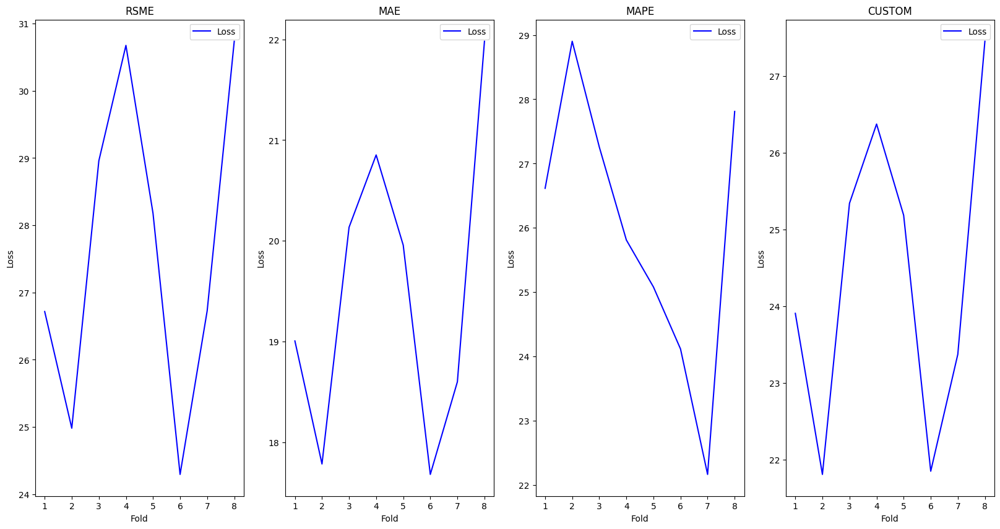

In [7]:
RSMEs_1 = pd.DataFrame()
MAEs_1 = pd.DataFrame()
MAPEs_1 = pd.DataFrame()
CUSTOMs_1 = pd.DataFrame()
for k in range(K):
    test_set = RCV.getKthTestSet(k+1).sort_values(by=['id', 'dzien_rozliczenia']).reset_index(drop=True).drop(columns=['id', 'dzien_rozliczenia'])
    pred_set = mean_predictions[k].drop(columns=['id', 'dzien_rozliczenia'])
    RSMEs_1 = pd.concat([RSMEs_1, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_1 = pd.concat([MAEs_1, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_1 = pd.concat([MAPEs_1, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_1 = pd.concat([CUSTOMs_1, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_1)
RSMEs.append(RSMEs_1)
MAPEs.append(MAPEs_1)
CUSTOMs.append(CUSTOMs_1)
viz.show_losses([['RSME', RSMEs_1], ['MAE', MAEs_1], ['MAPE', MAPEs_1], ['CUSTOM', CUSTOMs_1]], show_product)

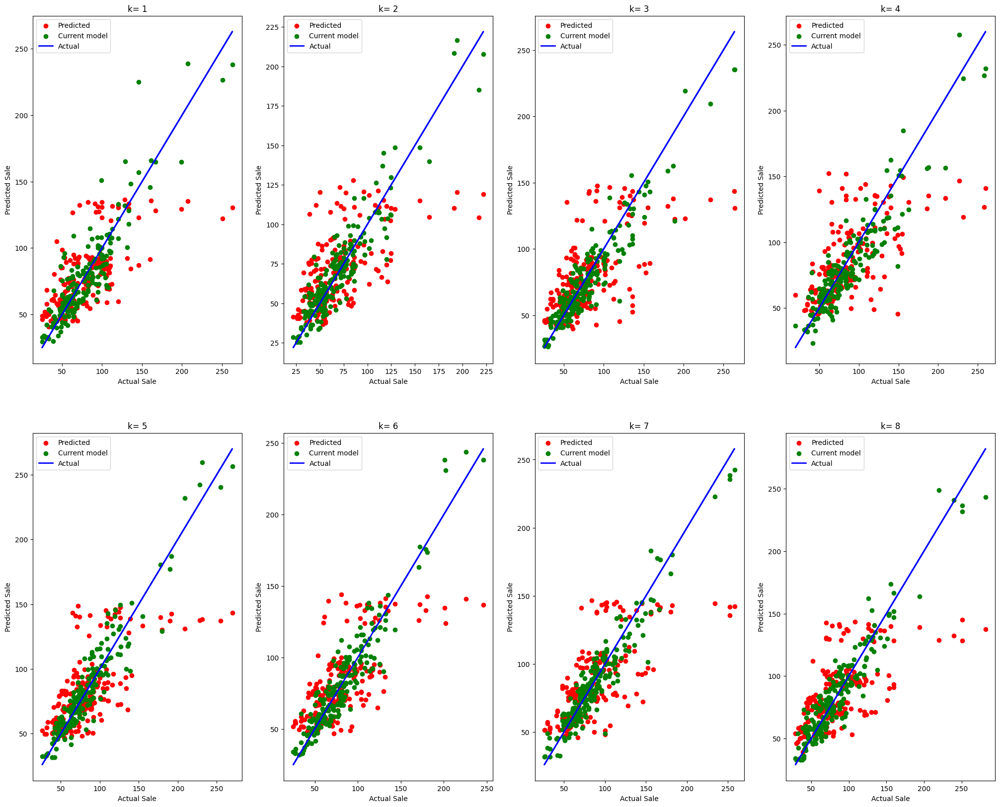

In [8]:
viz.show_estimations(K, mean_predictions, test_sets, show_product)

### Sale value from N sales days back

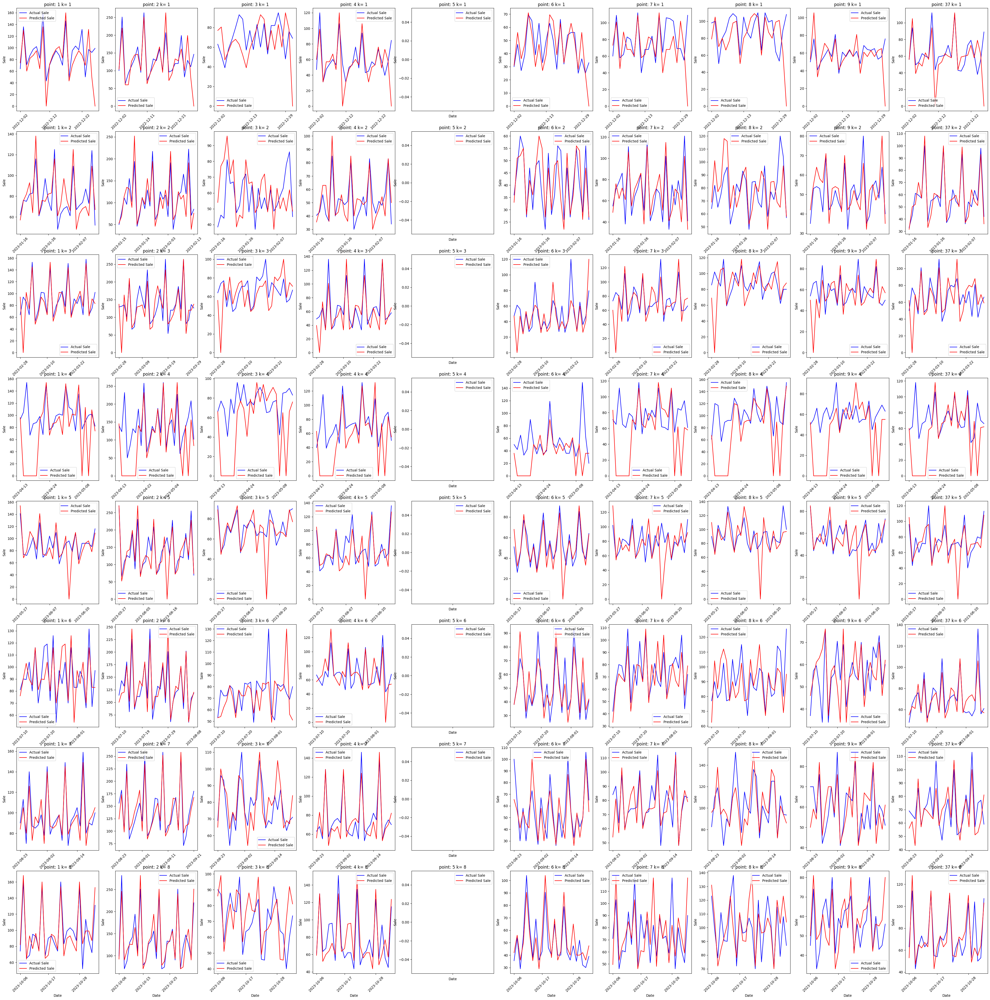

In [9]:
n_back_predictions = []
for k in range(1, K+1):
    pred = predictions.getPredictions("n_back_predictions", k)
    n_back_predictions.append(pred)
viz.show_sales(n_back_predictions, test_sets, points_of_sales, show_product)

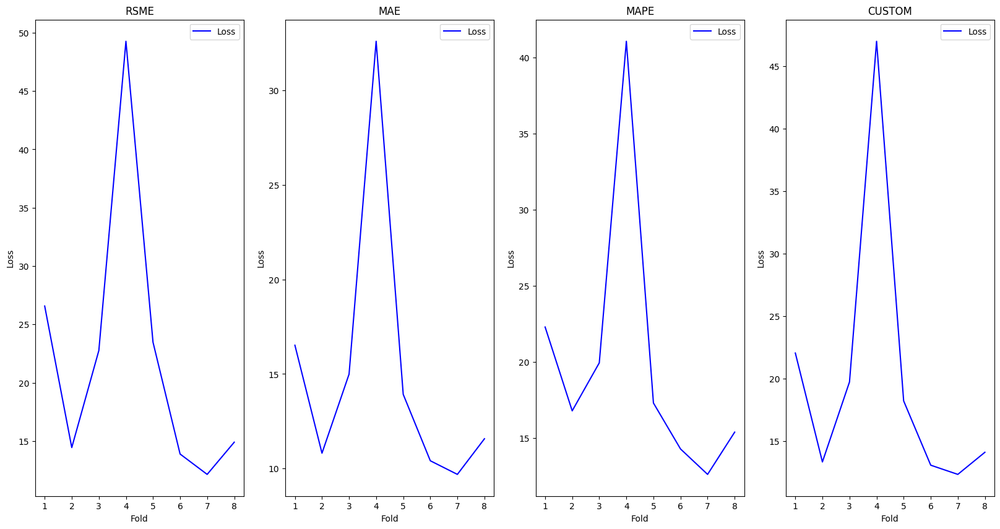

In [10]:
RSMEs_2 = pd.DataFrame()
MAEs_2 = pd.DataFrame()
MAPEs_2 = pd.DataFrame()
CUSTOMs_2 = pd.DataFrame()
for k in range(K):
    test_set = RCV.getKthTestSet(k+1).sort_values(by=['id', 'dzien_rozliczenia']).reset_index(drop=True).drop(columns=['id', 'dzien_rozliczenia'])
    pred_set = n_back_predictions[k].drop(columns=['id', 'dzien_rozliczenia'])
    RSMEs_2 = pd.concat([RSMEs_2, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_2 = pd.concat([MAEs_2, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_2 = pd.concat([MAPEs_2, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_2 = pd.concat([CUSTOMs_2, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_2)
RSMEs.append(RSMEs_2)
MAPEs.append(MAPEs_2)
CUSTOMs.append(CUSTOMs_2)
viz.show_losses([['RSME', RSMEs_2], ['MAE', MAEs_2], ['MAPE', MAPEs_2], ['CUSTOM', CUSTOMs_2]], show_product)

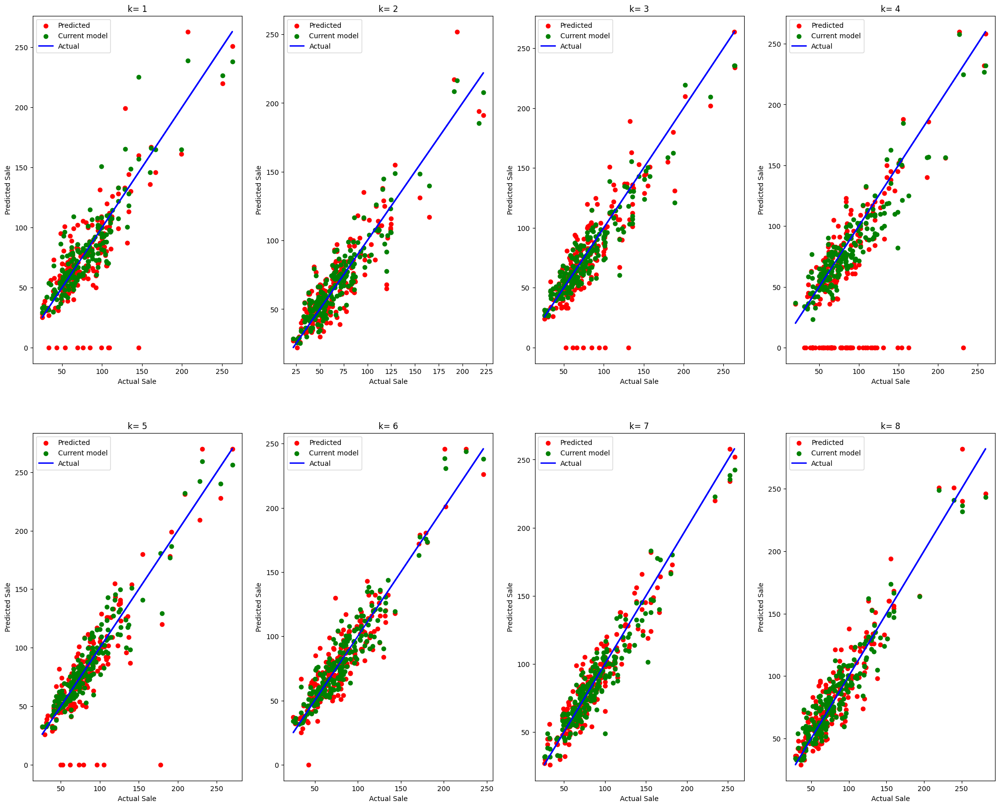

In [11]:
viz.show_estimations(K, n_back_predictions, test_sets, show_product)

### Mean value from same days in last N weeks

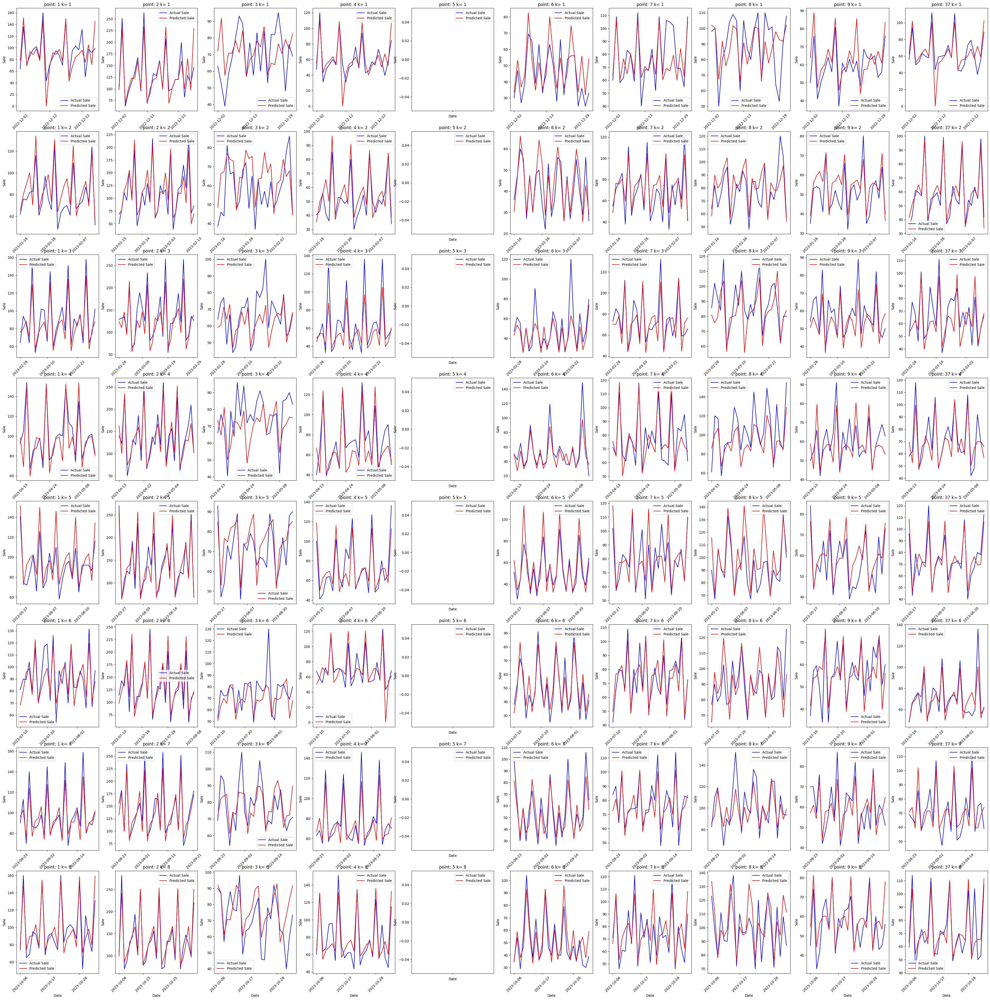

In [12]:
n_weeks_predictions = []
for k in range(1, K+1):
    pred = predictions.getPredictions("n_weeks_predictions", k)
    n_weeks_predictions.append(pred)
viz.show_sales(n_weeks_predictions, test_sets, points_of_sales, show_product)

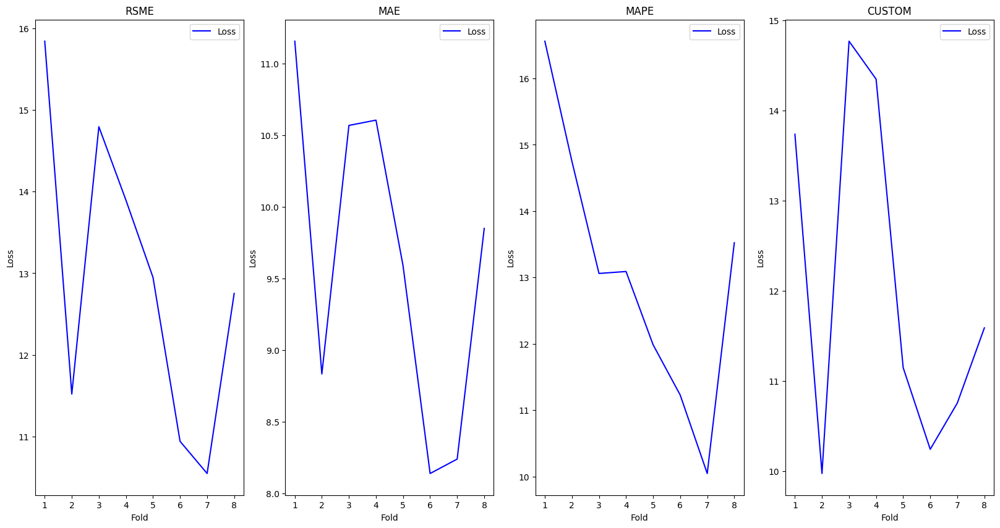

In [13]:
RSMEs_3 = pd.DataFrame()
MAEs_3 = pd.DataFrame()
MAPEs_3 = pd.DataFrame()
CUSTOMs_3 = pd.DataFrame()
for k in range(K):
    test_set = RCV.getKthTestSet(k+1).sort_values(by=['id', 'dzien_rozliczenia']).reset_index(drop=True).drop(columns=['id', 'dzien_rozliczenia'])
    pred_set = n_weeks_predictions[k].drop(columns=['id', 'dzien_rozliczenia'])
    RSMEs_3 = pd.concat([RSMEs_3, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_3 = pd.concat([MAEs_3, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_3 = pd.concat([MAPEs_3, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_3 = pd.concat([CUSTOMs_3, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_3)
RSMEs.append(RSMEs_3)
MAPEs.append(MAPEs_3)
CUSTOMs.append(CUSTOMs_3)
viz.show_losses([['RSME', RSMEs_3], ['MAE', MAEs_3], ['MAPE', MAPEs_3], ['CUSTOM', CUSTOMs_3]], show_product)

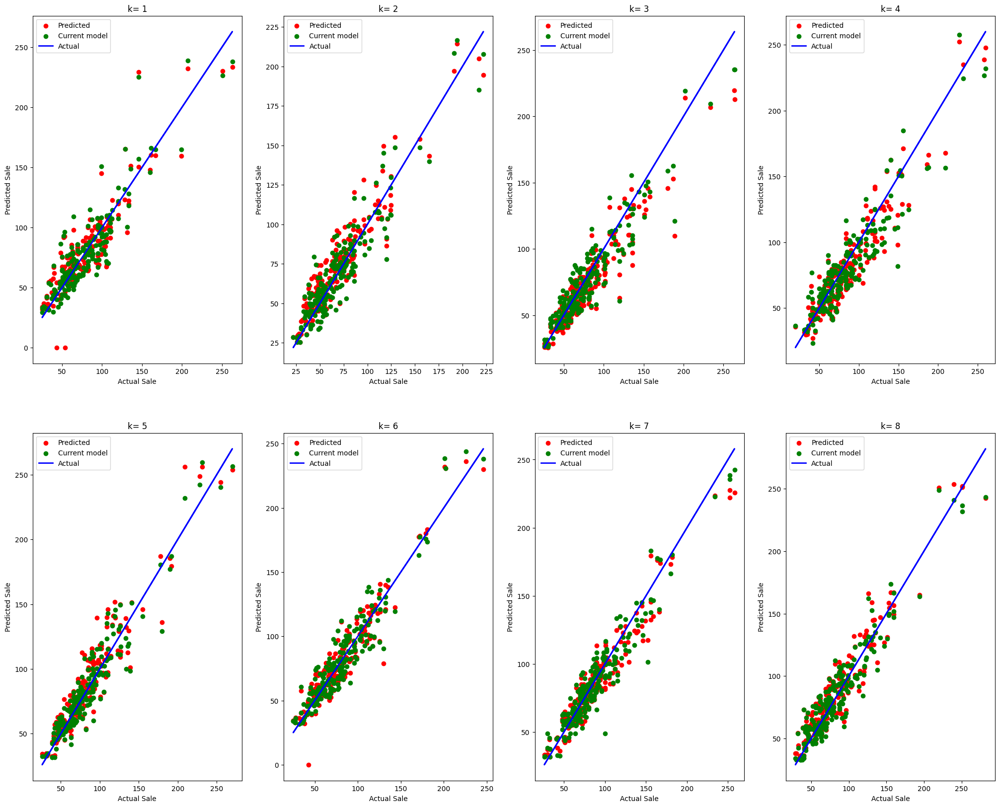

In [14]:
viz.show_estimations(K, n_weeks_predictions, test_sets, show_product)

### EWMA

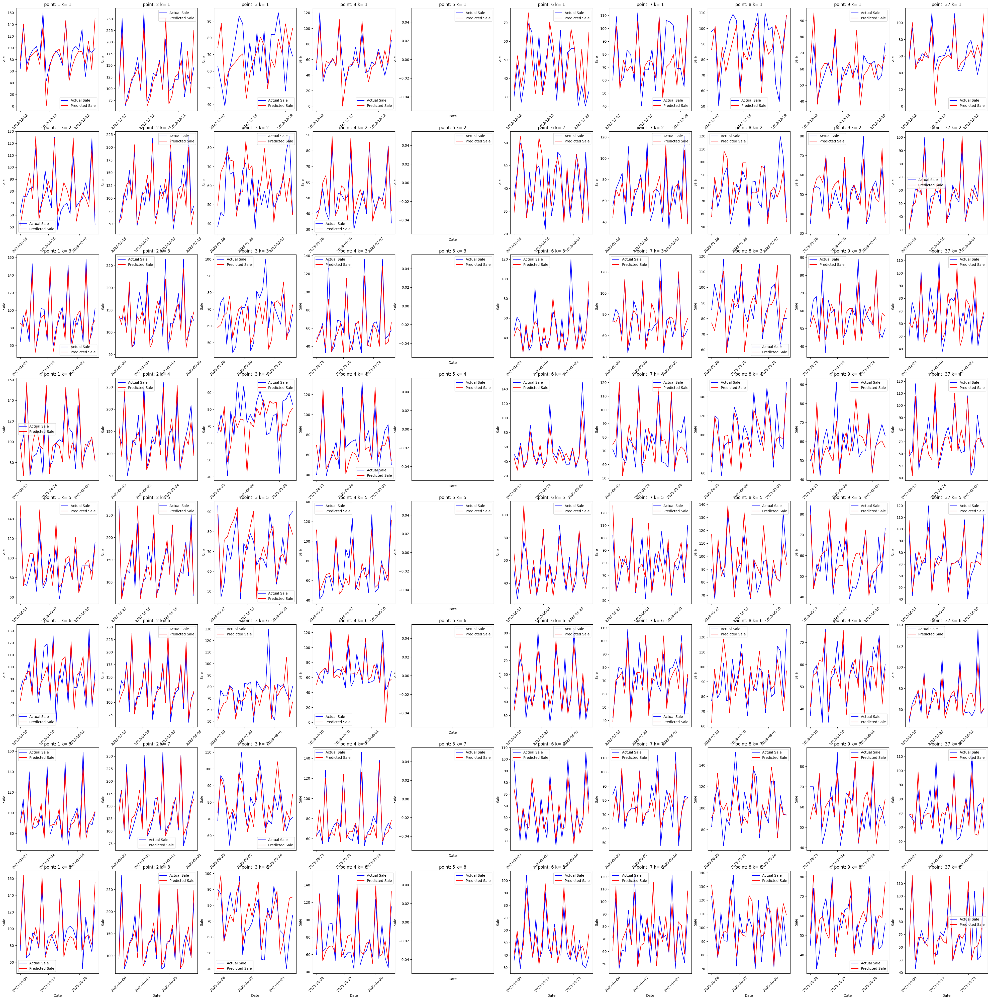

In [15]:
ewma_predictions = []
for k in range(1, K+1):
    pred = predictions.getPredictions("ewma_predictions", k)
    ewma_predictions.append(pred)
viz.show_sales(ewma_predictions, test_sets, points_of_sales, show_product)

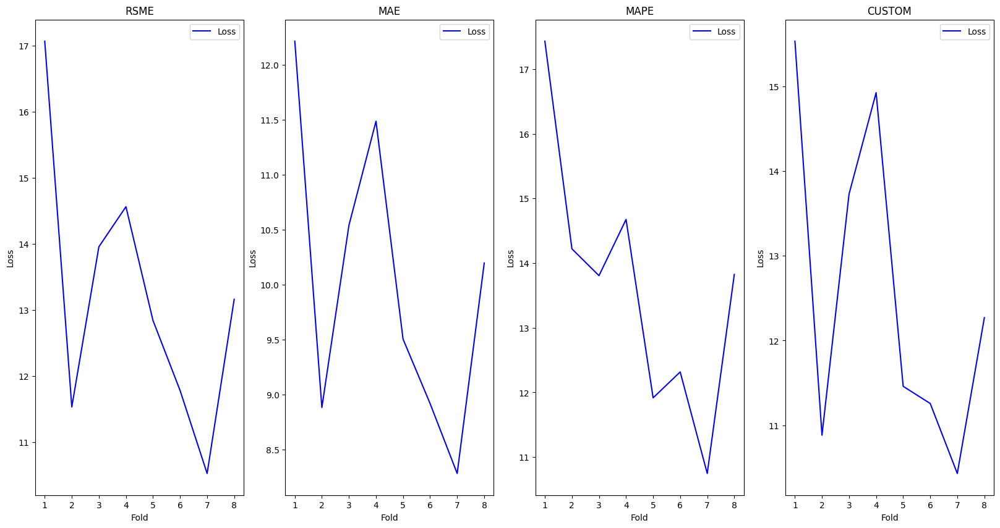

In [16]:
RSMEs_EWMA = pd.DataFrame()
MAEs_EWMA = pd.DataFrame()
MAPEs_EWMA = pd.DataFrame()
CUSTOMs_EWMA = pd.DataFrame()
for k in range(K):
    test_set = RCV.getKthTestSet(k+1).sort_values(by=['id', 'dzien_rozliczenia']).reset_index(drop=True).drop(columns=['id', 'dzien_rozliczenia'])
    pred_set = ewma_predictions[k].drop(columns=['id', 'dzien_rozliczenia'])
    RSMEs_EWMA = pd.concat([RSMEs_EWMA, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_EWMA = pd.concat([MAEs_EWMA, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_EWMA = pd.concat([MAPEs_EWMA, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_EWMA = pd.concat([CUSTOMs_EWMA, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_EWMA)
RSMEs.append(RSMEs_EWMA)
MAPEs.append(MAPEs_EWMA)
CUSTOMs.append(CUSTOMs_EWMA)
viz.show_losses([['RSME', RSMEs_EWMA], ['MAE', MAEs_EWMA], ['MAPE', MAPEs_EWMA], ['CUSTOM', CUSTOMs_EWMA]], show_product)

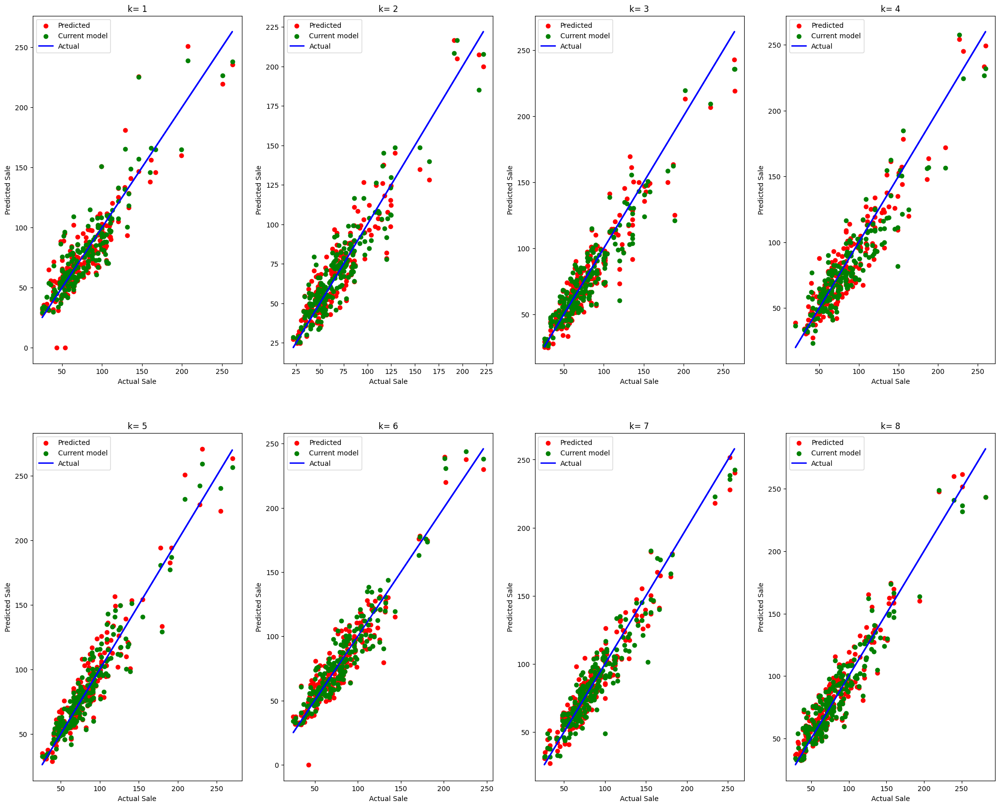

In [17]:
viz.show_estimations(K, ewma_predictions, test_sets, show_product)

### KNN (for each point new model)

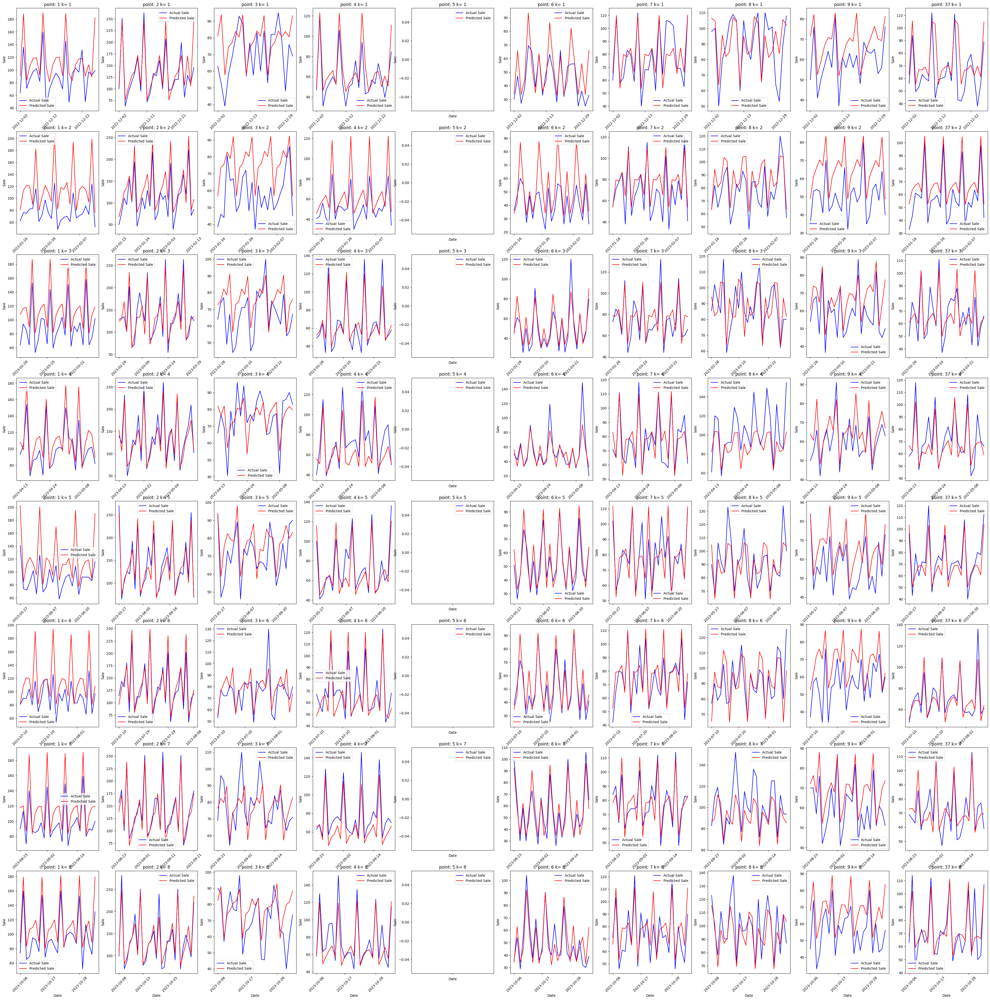

In [18]:
knn_predictions = []
for k in range(1, K+1):
    preds = predictions.getPredictions("knn_predictions", k)
    knn_predictions.append(preds)
viz.show_sales(knn_predictions, test_sets_ML, points_of_sales, show_product)

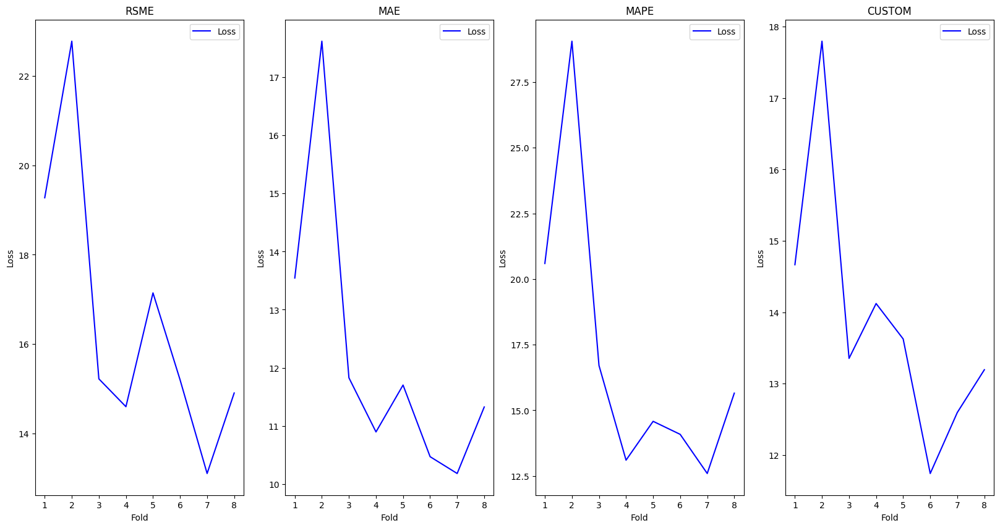

In [19]:
RSMEs_4 = pd.DataFrame()
MAEs_4 = pd.DataFrame()
MAPEs_4 = pd.DataFrame()
CUSTOMs_4 = pd.DataFrame()
for k in range(K):
    test_set = RCV.getKthTestSet(k+1, isML=True).sort_values(by=['dzien_rozliczenia', 'id']).reset_index(drop=True)
    test_set = pd.DataFrame(test_set[['product1', 'product2']])
    pred_set = knn_predictions[k].sort_values(by=['dzien_rozliczenia', 'id']).drop(columns=['id', 'dzien_rozliczenia']).reset_index(drop=True)
    RSMEs_4 = pd.concat([RSMEs_4, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_4 = pd.concat([MAEs_4, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_4 = pd.concat([MAPEs_4, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_4 = pd.concat([CUSTOMs_4, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_4)
RSMEs.append(RSMEs_4)
MAPEs.append(MAPEs_4)
CUSTOMs.append(CUSTOMs_4)
viz.show_losses([['RSME', RSMEs_4], ['MAE', MAEs_4], ['MAPE', MAPEs_4], ['CUSTOM', CUSTOMs_4]], show_product)

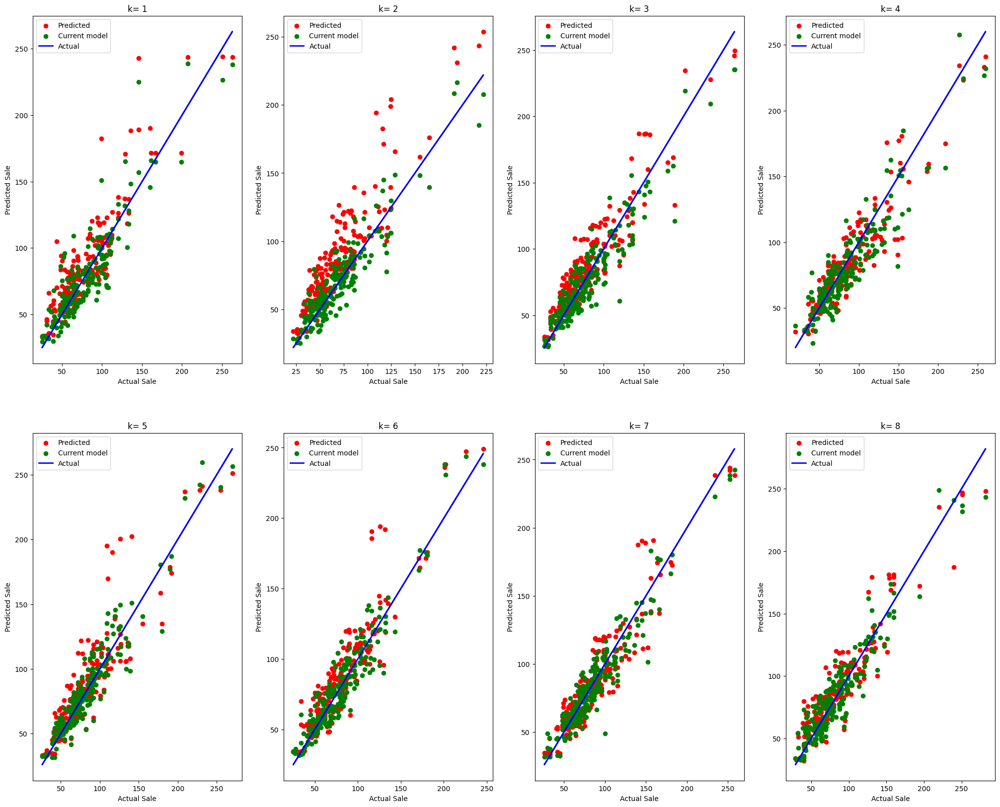

In [20]:
viz.show_estimations(K, knn_predictions, test_sets, show_product)

### KNN (all points)

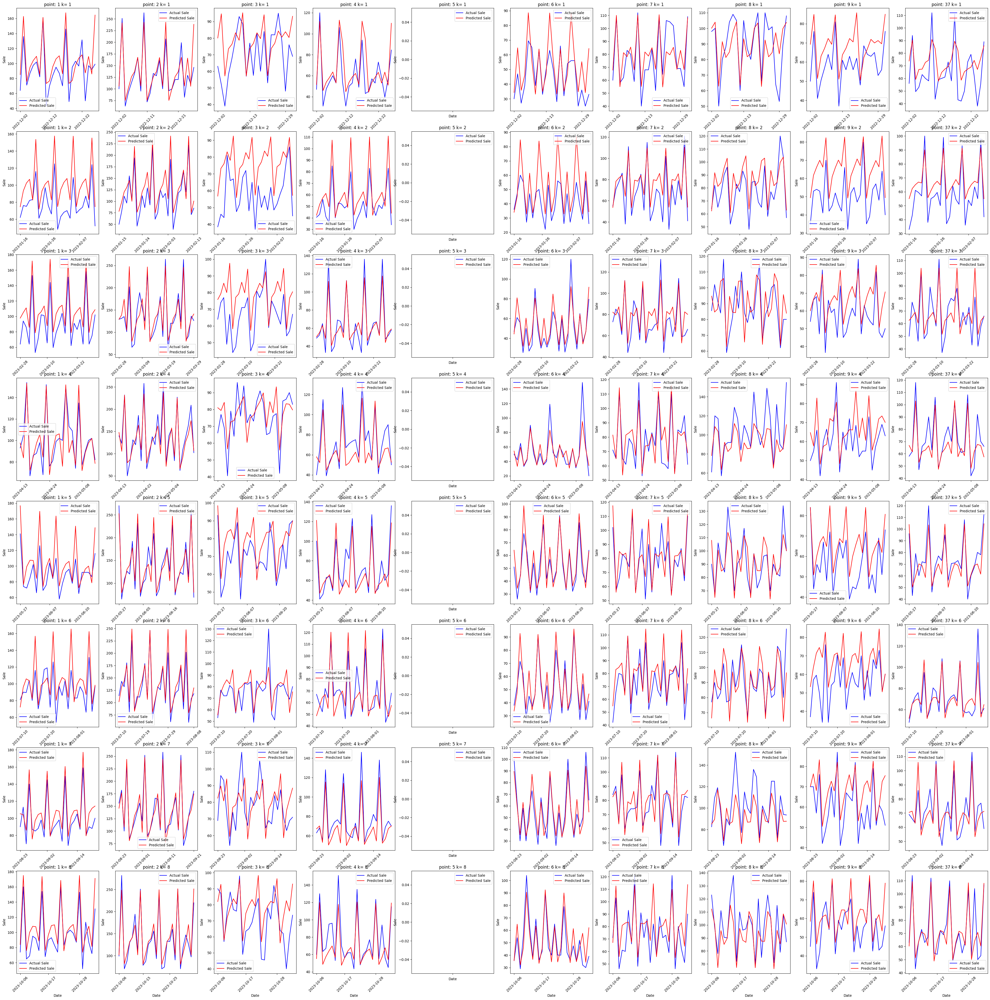

In [21]:
knn_all_predictions = []
for k in range(1, K+1):
    pred = predictions.getPredictions("knn_all_predictions", k)
    knn_all_predictions.append(pred)
viz.show_sales(knn_all_predictions, test_sets_ML, points_of_sales, show_product)

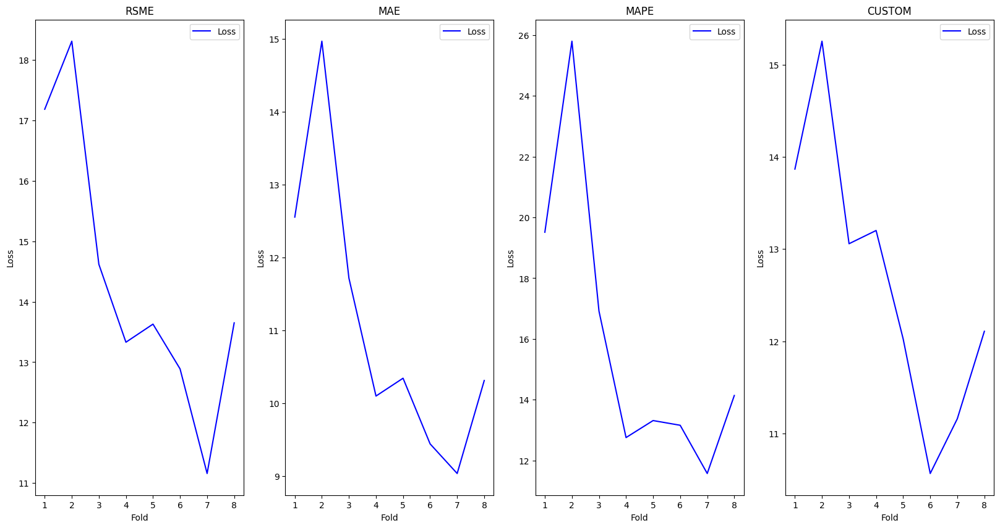

In [22]:
RSMEs_5 = pd.DataFrame()
MAEs_5 = pd.DataFrame()
MAPEs_5 = pd.DataFrame()
CUSTOMs_5 = pd.DataFrame()
for k in range(K):
    test_set = pd.DataFrame(RCV.getKthTestSet(k+1, isML=True)[['product1', 'product2']])
    pred_set = knn_all_predictions[k].drop(columns=['id', 'dzien_rozliczenia'])
    RSMEs_5 = pd.concat([RSMEs_5, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_5 = pd.concat([MAEs_5, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_5 = pd.concat([MAPEs_5, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_5 = pd.concat([CUSTOMs_5, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_5)
RSMEs.append(RSMEs_5)
MAPEs.append(MAPEs_5)
CUSTOMs.append(CUSTOMs_5)
viz.show_losses([['RSME', RSMEs_5], ['MAE', MAEs_5], ['MAPE', MAPEs_5], ['CUSTOM', CUSTOMs_5]], show_product)

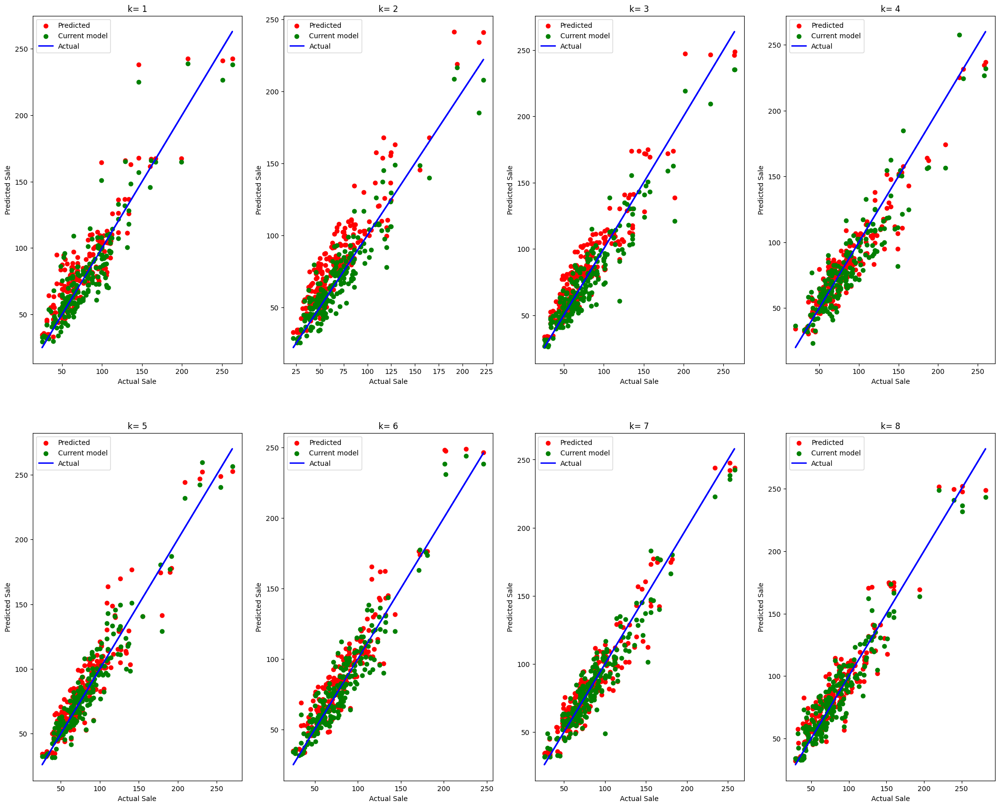

In [23]:
viz.show_estimations(K, knn_all_predictions, test_sets, show_product)

### Random Forest (for each point new model)

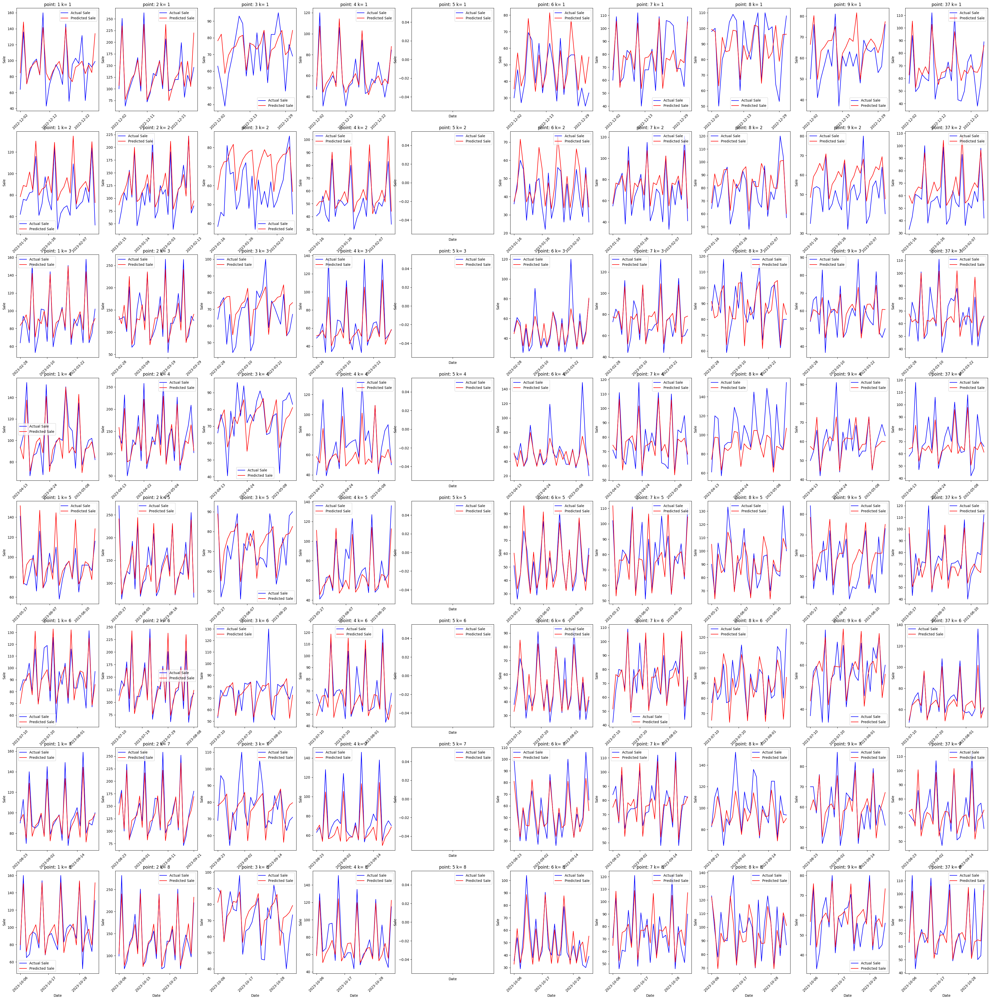

In [24]:
rf_predictions = []
for k in range(1, K+1):
    preds = predictions.getPredictions("rf_predictions", k)
    rf_predictions.append(preds)
viz.show_sales(rf_predictions, test_sets_ML, points_of_sales, show_product)

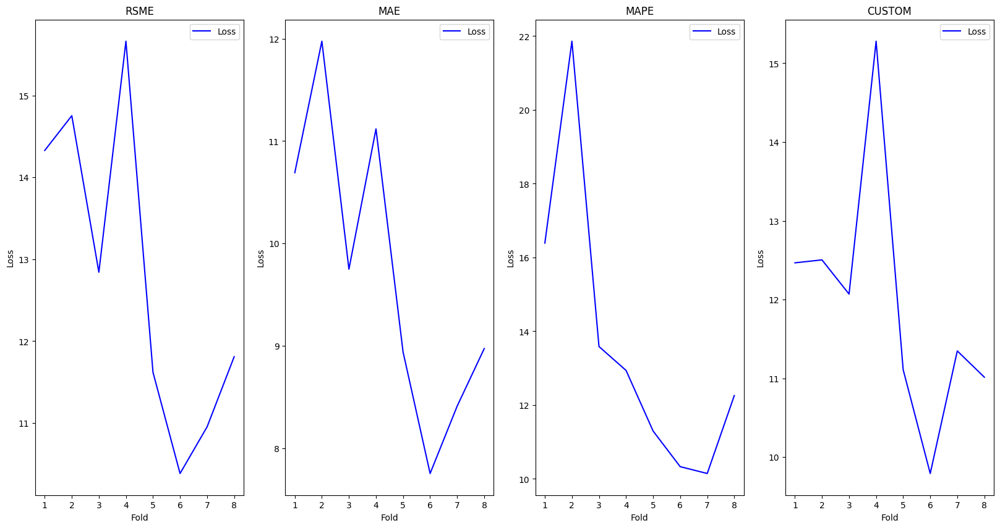

In [25]:
RSMEs_6 = pd.DataFrame()
MAEs_6 = pd.DataFrame()
MAPEs_6 = pd.DataFrame()
CUSTOMs_6 = pd.DataFrame()
for k in range(K):
    test_set = RCV.getKthTestSet(k+1, isML=True).sort_values(by=['dzien_rozliczenia', 'id']).reset_index(drop=True)
    test_set = pd.DataFrame(test_set[['product1', 'product2']])
    pred_set = rf_predictions[k].sort_values(by=['dzien_rozliczenia', 'id']).drop(columns=['id', 'dzien_rozliczenia']).reset_index(drop=True)
    RSMEs_6 = pd.concat([RSMEs_6, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_6 = pd.concat([MAEs_6, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_6 = pd.concat([MAPEs_6, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_6 = pd.concat([CUSTOMs_6, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_6)
RSMEs.append(RSMEs_6)
MAPEs.append(MAPEs_6)
CUSTOMs.append(CUSTOMs_6)
viz.show_losses([['RSME', RSMEs_6], ['MAE', MAEs_6], ['MAPE', MAPEs_6], ['CUSTOM', CUSTOMs_6]], show_product)

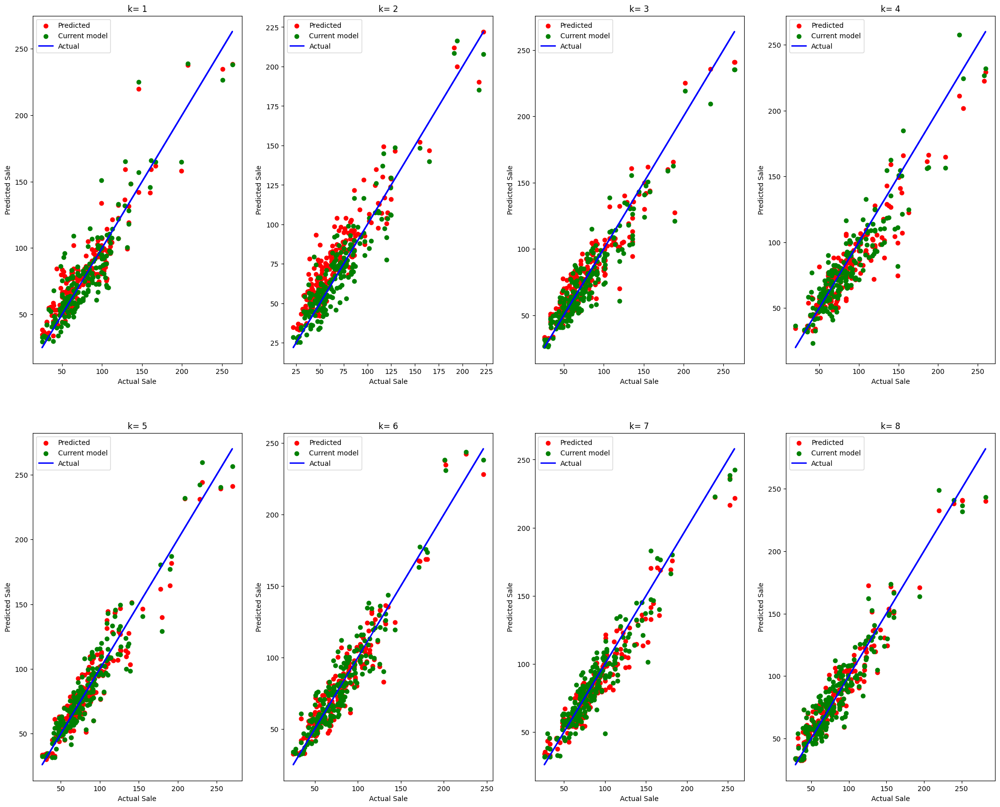

In [26]:
viz.show_estimations(K, rf_predictions, test_sets, show_product)

### Random Forest (all points)

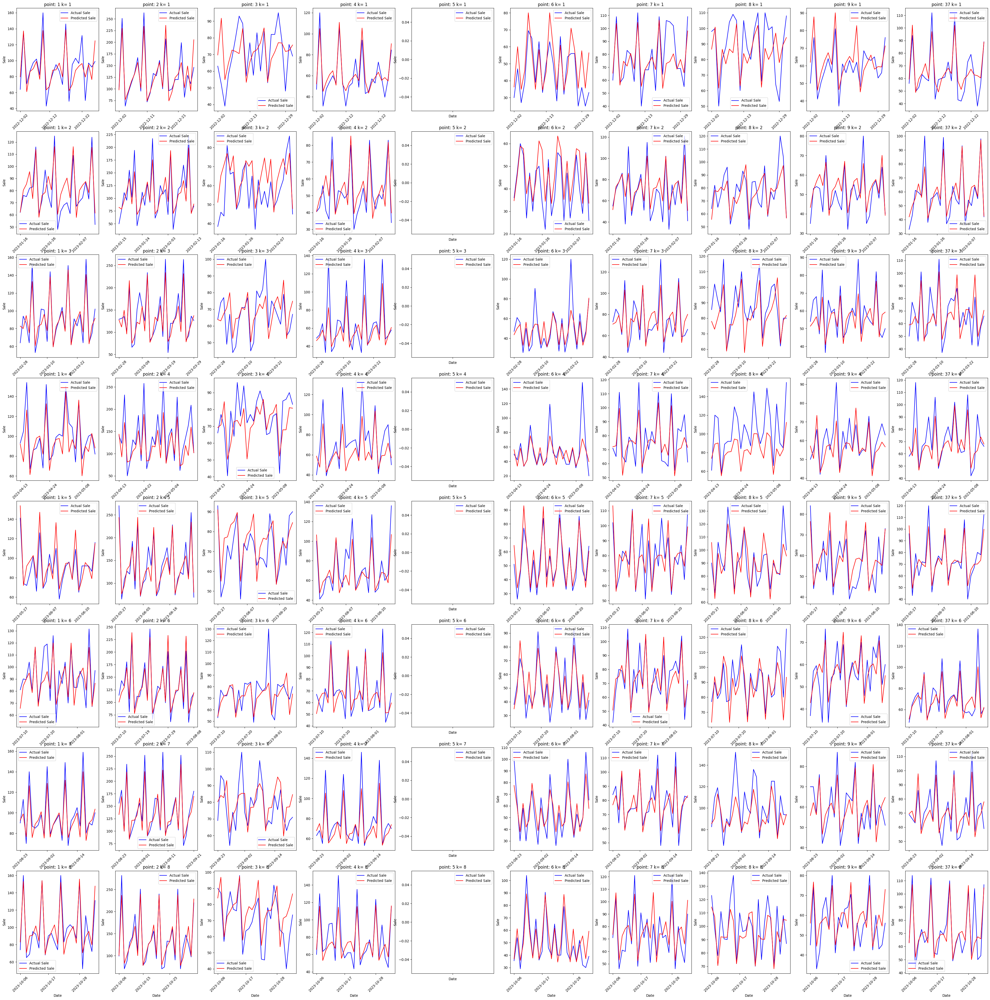

In [27]:
rf_all_predictions = []
for k in range(1, K+1):
    pred = predictions.getPredictions("rf_all_predictions", k)
    rf_all_predictions.append(pred)
viz.show_sales(rf_all_predictions, test_sets_ML, points_of_sales, show_product)

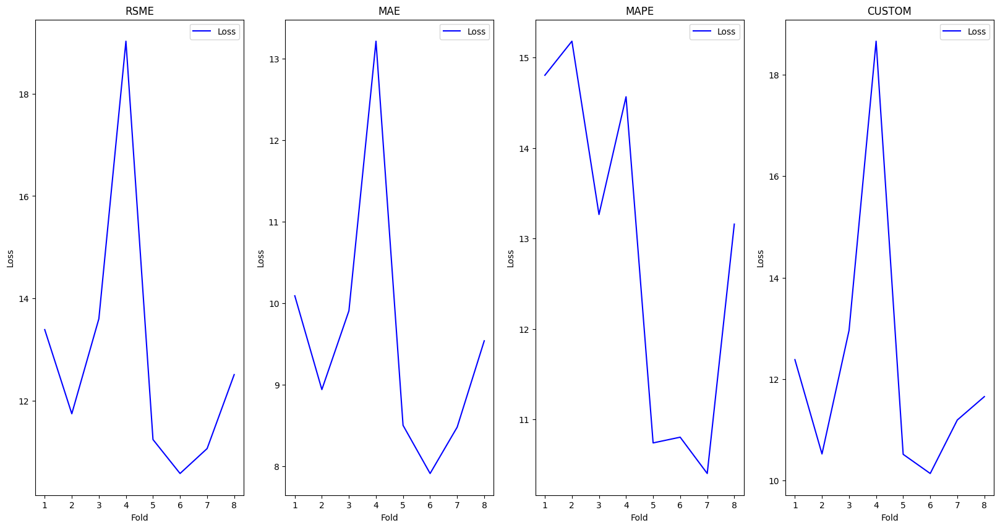

In [28]:
RSMEs_7 = pd.DataFrame()
MAEs_7 = pd.DataFrame()
MAPEs_7 = pd.DataFrame()
CUSTOMs_7 = pd.DataFrame()
for k in range(K):
    test_set = pd.DataFrame(RCV.getKthTestSet(k+1, isML=True)[['product1', 'product2']])
    pred_set = rf_all_predictions[k].drop(columns=['id', 'dzien_rozliczenia'])
    RSMEs_7 = pd.concat([RSMEs_7, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_7 = pd.concat([MAEs_7, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_7 = pd.concat([MAPEs_7, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_7 = pd.concat([CUSTOMs_7, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_7)
RSMEs.append(RSMEs_7)
MAPEs.append(MAPEs_7)
CUSTOMs.append(CUSTOMs_7)
viz.show_losses([['RSME', RSMEs_7], ['MAE', MAEs_7], ['MAPE', MAPEs_7], ['CUSTOM', CUSTOMs_7]], show_product)

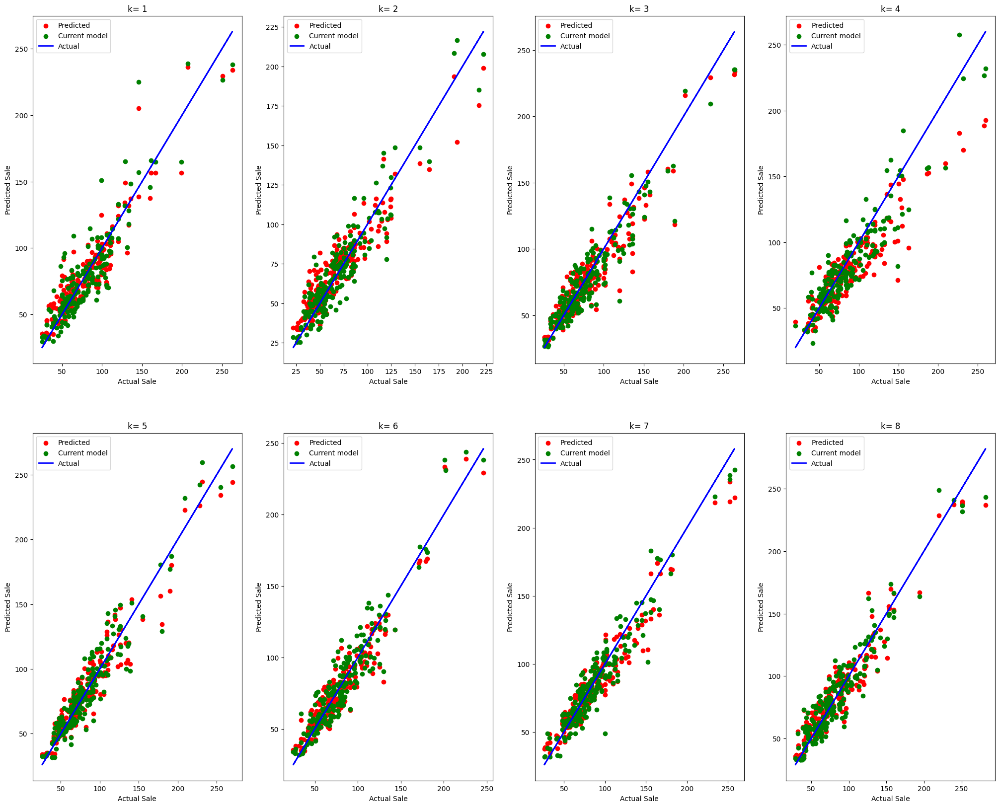

In [29]:
viz.show_estimations(K, rf_all_predictions, test_sets, show_product)

### Select best models

In [30]:
MAEs.pop(4)
RSMEs.pop(4)
MAPEs.pop(4)
CUSTOMs.pop(4)

MAEs.pop(6)
RSMEs.pop(6)
MAPEs.pop(6)
CUSTOMs.pop(6)

,product1,product2
0,12.382859,8.949012
1,10.523870,7.339016
2,12.959598,9.604217
3,18.661895,12.655199
4,10.516492,8.013527
5,10.138592,7.410536
6,11.192909,8.296347
7,11.654152,8.662614


In [31]:
errors = pd.DataFrame(columns=['measure', 'model', 'product1', 'product2', 'product3', 'product4'])
models = [('mean_predictions', 0), ('n_back_predictions', 0), ('n_weeks_predictions', 0), ('ewma_predictions', 0), ('knn_all_predictions', 0), ('rf_all_predictions', 0)]
for error, name in [(MAEs, "MAE"), (RSMEs, "RMSE"), (MAPEs, "MAPE"), (CUSTOMs, "CUSTOM")]:
    for i in range(len(error)):
        err_avg = pd.DataFrame(error[i].mean(axis=0)).T
        err_avg['measure'] = name
        err_avg['model'] = models[i][0]
        errors = pd.concat([errors, err_avg], ignore_index=True)
display(errors)

,measure,model,product1,product2,product3,product4
0,MAE,mean_predictions,19.499355,10.189829,2.153823,0.945359
1,MAE,n_back_predictions,15.063749,10.586817,2.821699,1.106994
2,MAE,n_weeks_predictions,9.622091,7.070215,3.404364,0.956174
3,MAE,ewma_predictions,10.003362,7.606231,2.547533,1.000253
4,MAE,knn_all_predictions,11.057726,8.086787,NaN,NaN
5,MAE,rf_all_predictions,9.701350,6.993016,NaN,NaN
6,RMSE,mean_predictions,27.658719,13.719932,3.303880,1.318171
7,RMSE,n_back_predictions,22.184178,14.358715,4.275467,1.687553
8,RMSE,n_weeks_predictions,12.905119,9.383377,4.713079,1.363749
9,RMSE,ewma_predictions,13.177253,9.982290,3.859785,1.451581


### best models for MAE

In [32]:
errors[errors.measure == "MAE"]

,measure,model,product1,product2,product3,product4
0,MAE,mean_predictions,19.499355,10.189829,2.153823,0.945359
1,MAE,n_back_predictions,15.063749,10.586817,2.821699,1.106994
2,MAE,n_weeks_predictions,9.622091,7.070215,3.404364,0.956174
3,MAE,ewma_predictions,10.003362,7.606231,2.547533,1.000253
4,MAE,knn_all_predictions,11.057726,8.086787,NaN,NaN
5,MAE,rf_all_predictions,9.701350,6.993016,NaN,NaN


### best models for RMSE

In [33]:
errors[errors.measure == "RMSE"]

,measure,model,product1,product2,product3,product4
6,RMSE,mean_predictions,27.658719,13.719932,3.303880,1.318171
7,RMSE,n_back_predictions,22.184178,14.358715,4.275467,1.687553
8,RMSE,n_weeks_predictions,12.905119,9.383377,4.713079,1.363749
9,RMSE,ewma_predictions,13.177253,9.982290,3.859785,1.451581
10,RMSE,knn_all_predictions,14.346879,10.483459,NaN,NaN
11,RMSE,rf_all_predictions,12.794032,9.195916,NaN,NaN


### best models for MAPE

In [34]:
errors[errors.measure == "MAPE"]

,measure,model,product1,product2,product3,product4
12,MAPE,mean_predictions,25.970592,32.426469,inf,inf
13,MAPE,n_back_predictions,19.972213,31.654858,inf,inf
14,MAPE,n_weeks_predictions,13.031177,22.464430,inf,inf
15,MAPE,ewma_predictions,13.616566,24.217174,inf,inf
16,MAPE,knn_all_predictions,15.894838,26.879024,NaN,NaN
17,MAPE,rf_all_predictions,13.601252,23.183162,NaN,NaN


### best models for CUSTOM

In [35]:
errors[errors.measure == "CUSTOM"]

,measure,model,product1,product2,product3,product4
18,CUSTOM,mean_predictions,24.411860,12.744507,2.705061,1.182543
19,CUSTOM,n_back_predictions,19.963476,13.840607,3.546941,1.395328
20,CUSTOM,n_weeks_predictions,12.068357,8.869703,4.177313,1.219673
21,CUSTOM,ewma_predictions,12.561061,9.533167,3.122439,1.258306
22,CUSTOM,knn_all_predictions,12.655141,9.309351,NaN,NaN
23,CUSTOM,rf_all_predictions,11.947724,8.536974,NaN,NaN


### choose best models

In [36]:
def add_model_occ(model_name):
    for model in models:
        if model[0] == model_name:
            models.remove(model)
            models.append((model_name, model[1]+1))

In [37]:
def top_n_lowest(group, n=3):
    top_n = group.nsmallest(n, show_product)
    for index, t in top_n.iterrows():
        add_model_occ(t.model)
    return top_n

In [38]:
errors = errors.groupby(['measure'], group_keys=False).apply(top_n_lowest).reset_index(drop=True)

In [39]:
models.sort(key=lambda x: x[1], reverse=True)
choosen_models = []
for model in models[:3]:
    choosen_models.append(predictions.getPredictions(model[0]))

In [40]:
models[:3]

[('n_weeks_predictions', 8),
 ('ewma_predictions', 8),
 ('rf_all_predictions', 7)]

### Merged models

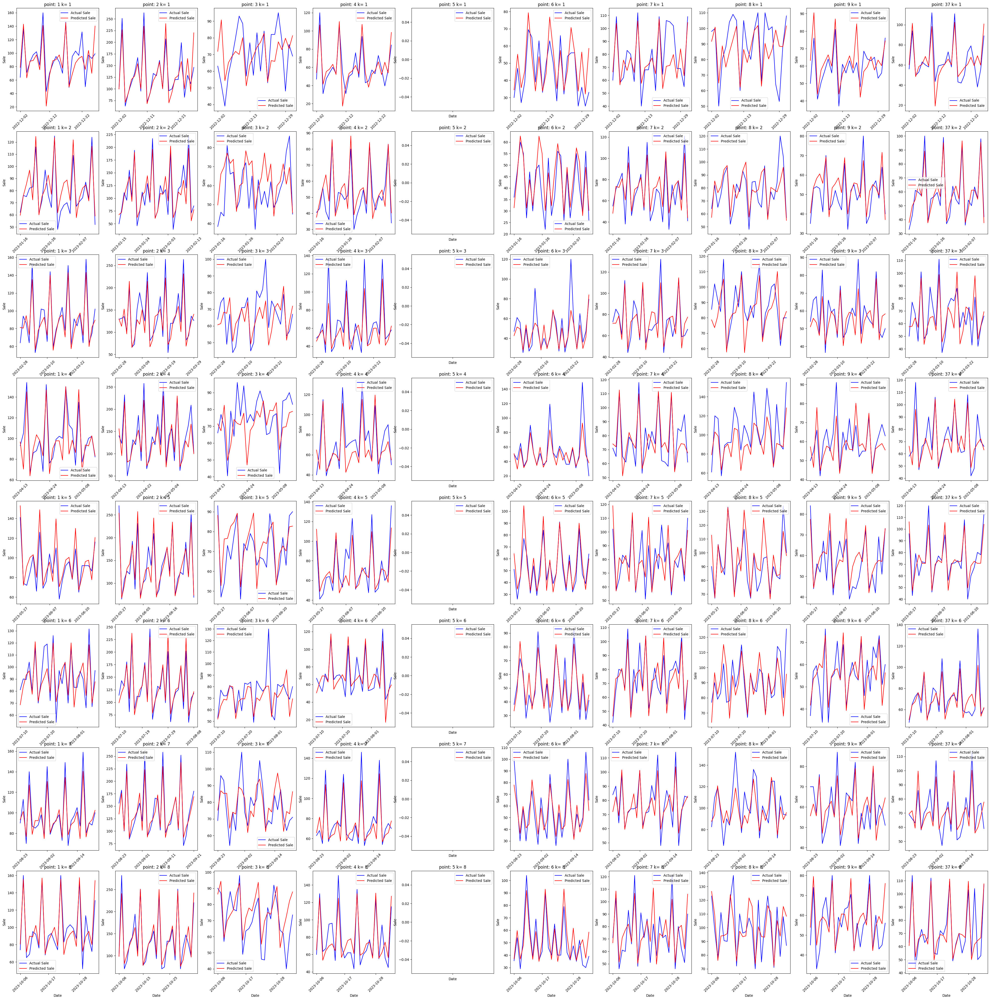

In [41]:
merged_predictions = []
for k in range(1, K+1):
    pred = choosen_models[0][choosen_models[0].k == k].copy()
    for i in range(1, len(choosen_models)):
        pred = pred.merge(choosen_models[i][choosen_models[i].k == k], on=['id', 'dzien_rozliczenia'], how='inner')
    pred['product1'] = pred[['product1_x', 'product1_y', 'product1']].mean(axis=1)
    pred['product2'] = pred[['product2_x', 'product2_y', 'product2']].mean(axis=1)
    pred = pred[['id', 'dzien_rozliczenia', 'product1', 'product2']]
    merged_predictions.append(pred)
viz.show_sales(merged_predictions, test_sets_ML, points_of_sales, show_product)

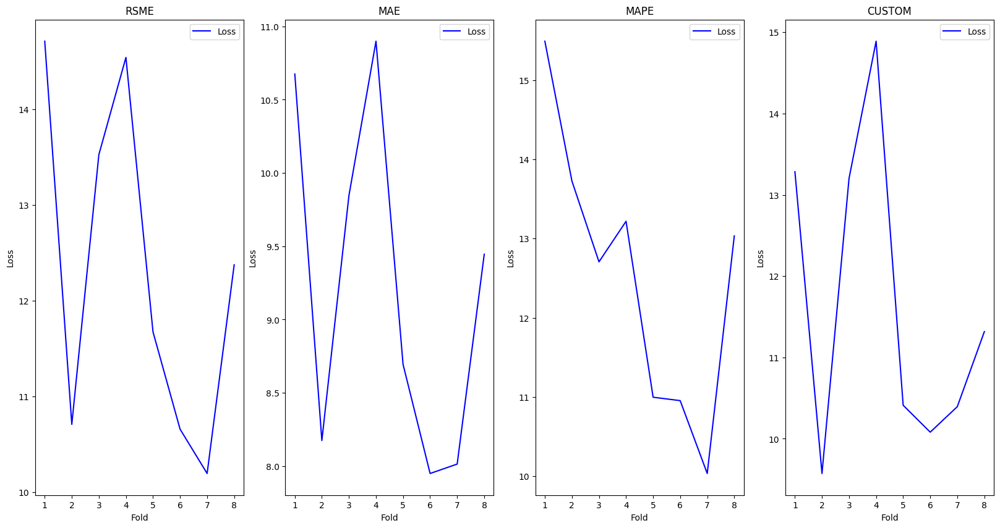

In [42]:
RSMEs_8 = pd.DataFrame()
MAEs_8 = pd.DataFrame()
MAPEs_8 = pd.DataFrame()
CUSTOMs_8 = pd.DataFrame()
for k in range(K):
    test_set = pd.DataFrame(RCV.getKthTestSet(k+1, isML=True))
    test_set.sort_values(by=['id', 'dzien_rozliczenia'], inplace=True)
    test_set = test_set.reset_index(drop=True)[['product1', 'product2']]
    pred_set = merged_predictions[k].drop(columns=['id', 'dzien_rozliczenia'])
    RSMEs_8 = pd.concat([RSMEs_8, Eval.RSME(pred_set, test_set)], ignore_index=True)
    MAEs_8 = pd.concat([MAEs_8, Eval.MAE(pred_set, test_set)], ignore_index=True)
    MAPEs_8 = pd.concat([MAPEs_8, Eval.MAPE(pred_set, test_set)], ignore_index=True)
    CUSTOMs_8 = pd.concat([CUSTOMs_8, Eval.CUSTOM(pred_set, test_set)], ignore_index=True)
MAEs.append(MAEs_8)
RSMEs.append(RSMEs_8)
MAPEs.append(MAPEs_8)
CUSTOMs.append(CUSTOMs_8)
viz.show_losses([['RSME', RSMEs_8], ['MAE', MAEs_8], ['MAPE', MAPEs_8], ['CUSTOM', CUSTOMs_8]], show_product)

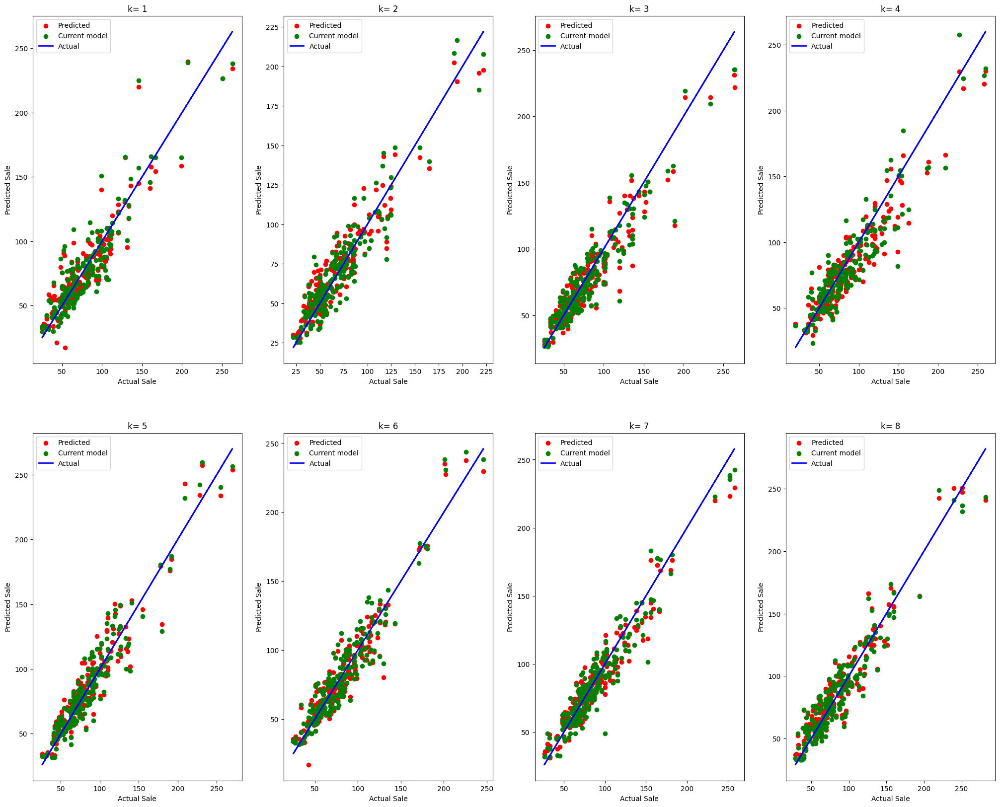

In [43]:
viz.show_estimations(K, merged_predictions, test_sets, show_product)

In [44]:
titles = ['Average', 'Back n days', 'Same days last n weeks', 'EWMA', 'KNN (all points)', ' Random Forest (all points)', 'merged']

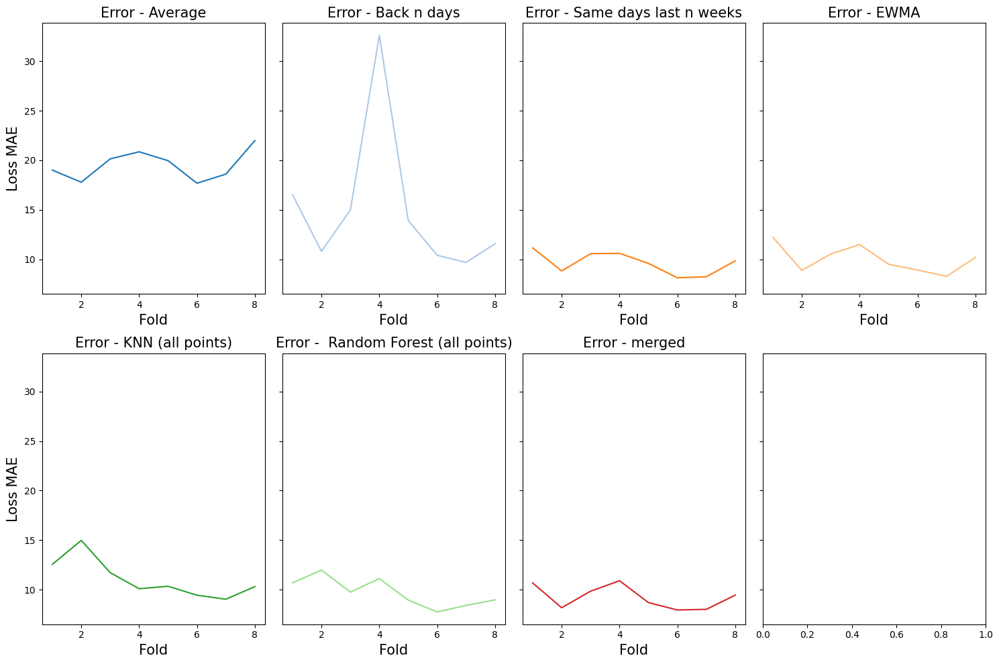

In [45]:
viz.show_error_summary(MAEs, show_product, 'MAE', titles)

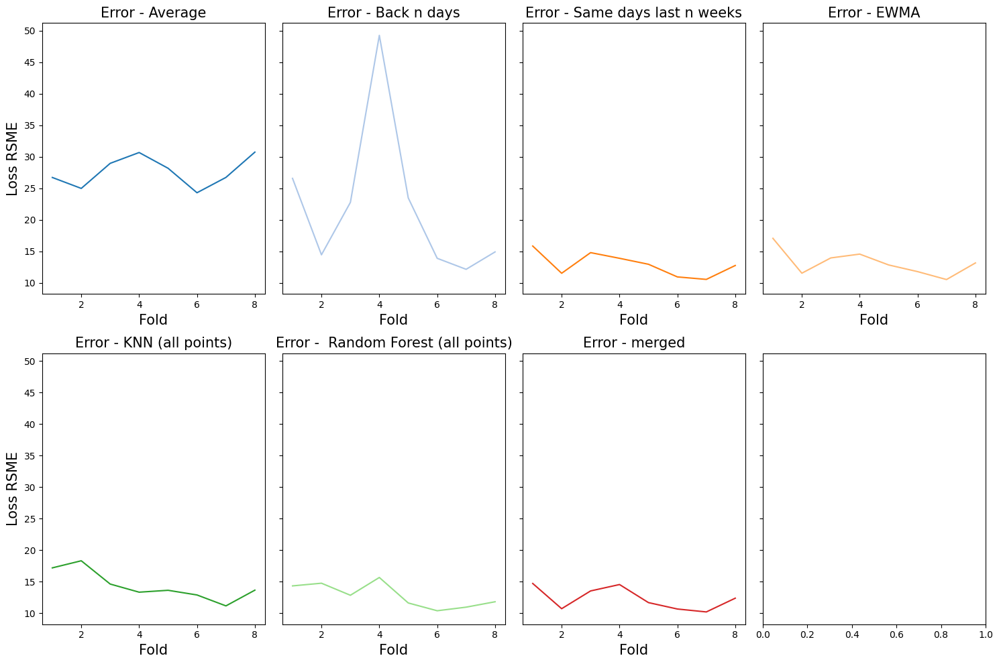

In [46]:
viz.show_error_summary(RSMEs, show_product, 'RSME', titles)

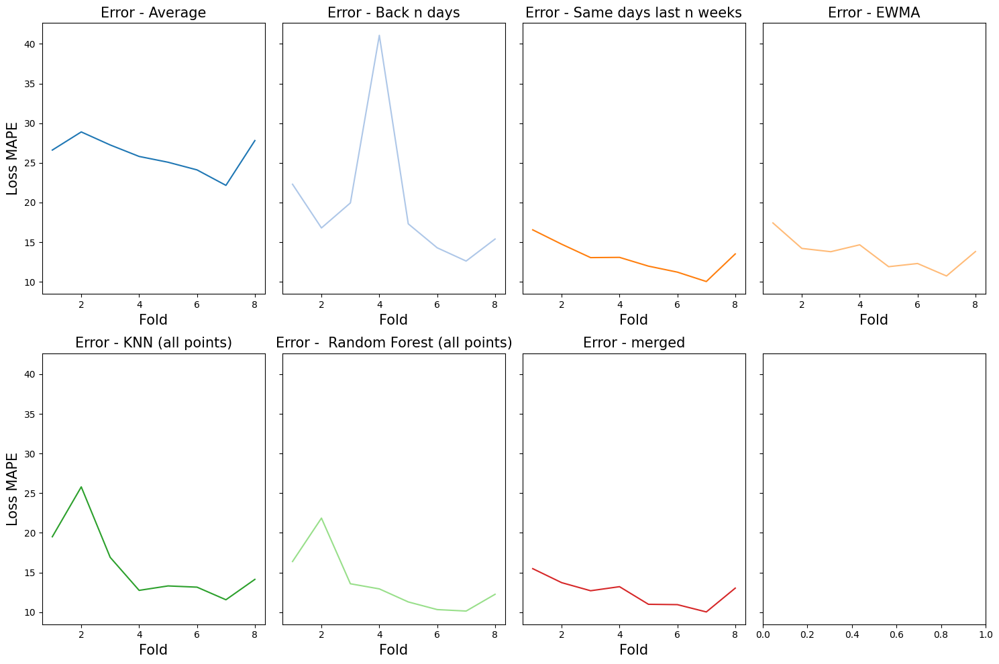

In [47]:
viz.show_error_summary(MAPEs, show_product, 'MAPE', titles)

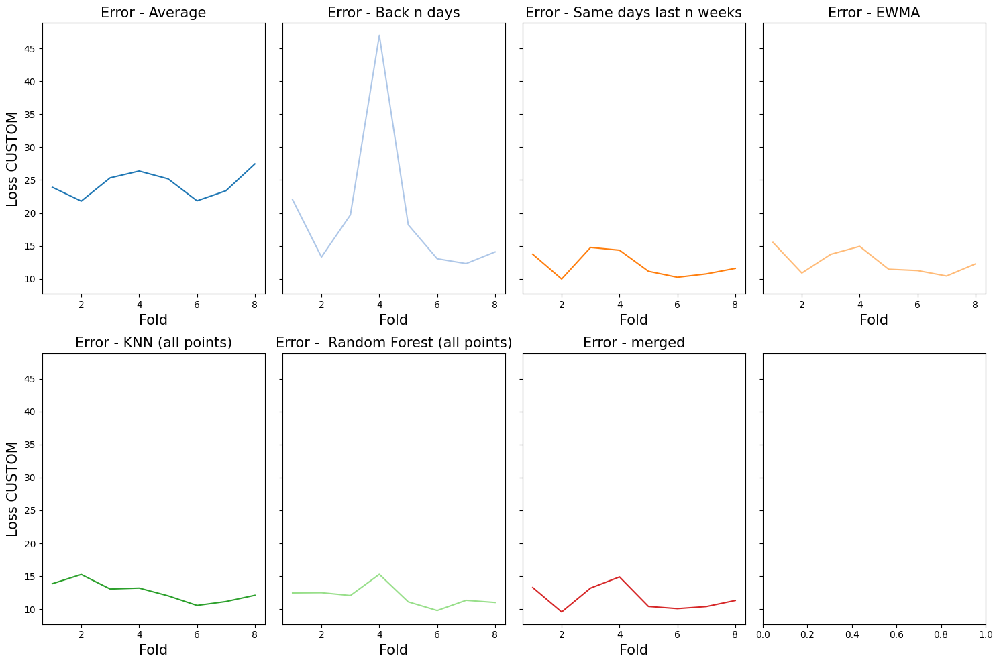

In [48]:
viz.show_error_summary(CUSTOMs, show_product, 'CUSTOM', titles)

### Compare models

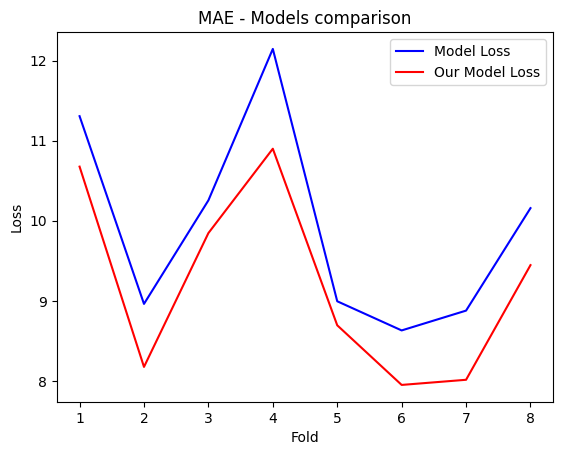

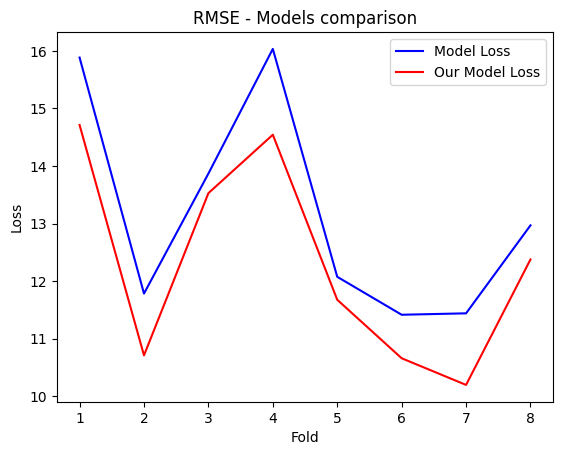

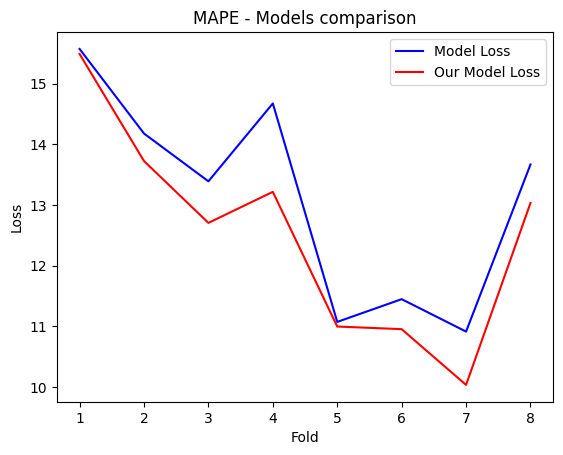

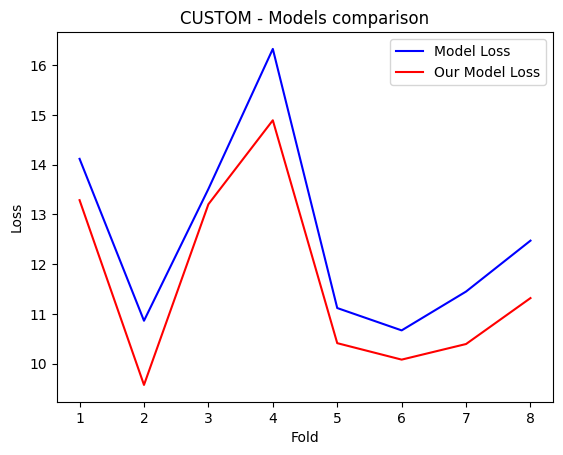

In [49]:
if show_product == 'product1':
    model_MAES = pd.DataFrame()
    model_RMSES = pd.DataFrame()
    model_MAPES = pd.DataFrame()
    model_CUSTOMS = pd.DataFrame()

    for i in range(1, K+1):
        test = RCV.getKthTestSet(i)
        mae, rmse, mape, custom = Eval.compare_models(test)
        model_MAES = pd.concat([model_MAES, mae], ignore_index=True)
        model_RMSES = pd.concat([model_RMSES, rmse], ignore_index=True)
        model_MAPES = pd.concat([model_MAPES, mape], ignore_index=True)
        model_CUSTOMS = pd.concat([model_CUSTOMS, custom], ignore_index=True)

    viz.show_models_comp(model_MAES, MAEs_8, 'MAE')
    viz.show_models_comp(model_RMSES, RSMEs_8, 'RMSE')
    viz.show_models_comp(model_MAPES, MAPEs_8, 'MAPE')
    viz.show_models_comp(model_CUSTOMS, CUSTOMs_8, 'CUSTOM')